<a href="https://colab.research.google.com/github/Dibyaroy25/Analysis-and-Prediction-of-Parkinson-s-Disease/blob/main/Parkinson's.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import files
files.upload()

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
data=pd.read_csv("/content/disese.txt")

In [ ]:
!pip install pandas-profiling==2.7.1

In [ ]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df = data)
profile.to_file(output_file = 'Pre Profiling Report.html')
print('Accomplished!')

In [ ]:
profile.to_notebook_iframe()

#Data Info

In [ ]:
data.head()

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,MDVP:APQ,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,0.426,0.02182,0.03130,0.02971,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,0.626,0.03134,0.04518,0.04368,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,0.482,0.02757,0.03858,0.03590,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,0.517,0.02924,0.04005,0.03772,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,0.584,0.03490,0.04825,0.04465,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335


##The first 5 rows of the dataset.

In [ ]:
data.shape

(195, 24)

##There are 195 rows and 24 columns.

In [ ]:
data.dtypes

name                 object
MDVP:Fo(Hz)         float64
MDVP:Fhi(Hz)        float64
MDVP:Flo(Hz)        float64
MDVP:Jitter(%)      float64
MDVP:Jitter(Abs)    float64
MDVP:RAP            float64
MDVP:PPQ            float64
Jitter:DDP          float64
MDVP:Shimmer        float64
MDVP:Shimmer(dB)    float64
Shimmer:APQ3        float64
Shimmer:APQ5        float64
MDVP:APQ            float64
Shimmer:DDA         float64
NHR                 float64
HNR                 float64
status                int64
RPDE                float64
DFA                 float64
spread1             float64
spread2             float64
D2                  float64
PPE                 float64
dtype: object

##There is one categorical column while rest are numeric.

In [ ]:
data.isnull().sum()

name                0
MDVP:Fo(Hz)         0
MDVP:Fhi(Hz)        0
MDVP:Flo(Hz)        0
MDVP:Jitter(%)      0
MDVP:Jitter(Abs)    0
MDVP:RAP            0
MDVP:PPQ            0
Jitter:DDP          0
MDVP:Shimmer        0
MDVP:Shimmer(dB)    0
Shimmer:APQ3        0
Shimmer:APQ5        0
MDVP:APQ            0
Shimmer:DDA         0
NHR                 0
HNR                 0
status              0
RPDE                0
DFA                 0
spread1             0
spread2             0
D2                  0
PPE                 0
dtype: int64

##There is no null value in any column.

In [ ]:
data.nunique()

name                195
MDVP:Fo(Hz)         195
MDVP:Fhi(Hz)        195
MDVP:Flo(Hz)        195
MDVP:Jitter(%)      173
MDVP:Jitter(Abs)     19
MDVP:RAP            155
MDVP:PPQ            165
Jitter:DDP          180
MDVP:Shimmer        188
MDVP:Shimmer(dB)    149
Shimmer:APQ3        184
Shimmer:APQ5        189
MDVP:APQ            189
Shimmer:DDA         189
NHR                 185
HNR                 195
status                2
RPDE                195
DFA                 195
spread1             195
spread2             194
D2                  195
PPE                 195
dtype: int64

##All the cols are highly unique.

##Since Column Name has all unique values, its better to drop.

In [ ]:
data.drop(['name'],inplace=True, axis = 1)
print("Done.")

Done.


#Column "Status" , "spread1" and "spread2"

---




/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


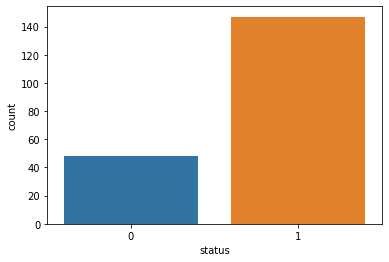

In [ ]:
sns.countplot(data["status"])

##Maximum people suffer with PD.

In [ ]:
data.groupby("status")["spread1"].describe()

,count,mean,std,min,25%,50%,75%,max
status,,,,,,,,
0,48.0,-6.759264,0.642782,-7.964984,-7.257665,-6.826448,-6.350146,-5.198864
1,147.0,-5.333420,0.970792,-7.120925,-6.038300,-5.440040,-4.664067,-2.434031


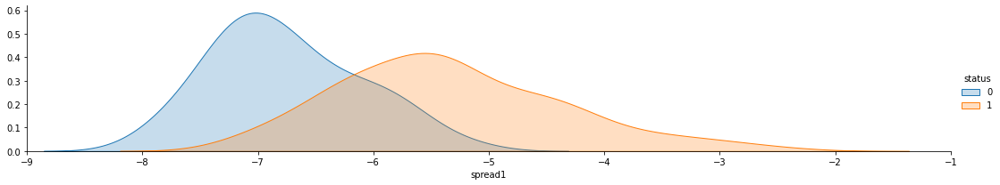

In [ ]:
as_fig = sns.FacetGrid(data,hue='status',aspect=5)

as_fig.map(sns.kdeplot,'spread1',shade=True)

oldest = data['spread1'].max()

as_fig.set(xlim=(-9,-1))

as_fig.add_legend()

##We see people having spread1 frequency greater than -5.198864 suffer with PD.

In [ ]:
data.groupby("status")["spread2"].describe()

,count,mean,std,min,25%,50%,75%,max
status,,,,,,,,
0,48.0,0.160292,0.062982,0.006274,0.120623,0.167356,0.193766,0.291954
1,147.0,0.248133,0.077809,0.063412,0.199507,0.240875,0.303660,0.450493


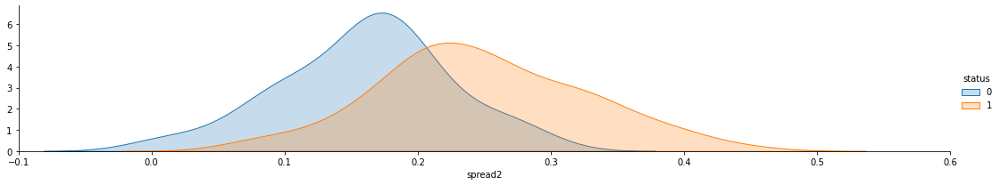

In [ ]:
as_fig = sns.FacetGrid(data,hue='status',aspect=5)

as_fig.map(sns.kdeplot,'spread2',shade=True)

oldest = data['spread2'].max()

as_fig.set(xlim=(-0.1,0.6))

as_fig.add_legend()

##We see people suffering with PD has avg spread2 frequency of 0.248133	 with max limit as 0.450493 while healthy has avg spread2 frequency of 0.160292		with max limit as 0.291954.

In [ ]:
data.groupby("status")["PPE"].describe()

,count,mean,std,min,25%,50%,75%,max
status,,,,,,,,
0,48.0,0.123017,0.044820,0.044539,0.094658,0.115119,0.147761,0.252404
1,147.0,0.233828,0.084271,0.093193,0.170103,0.222716,0.274397,0.527367


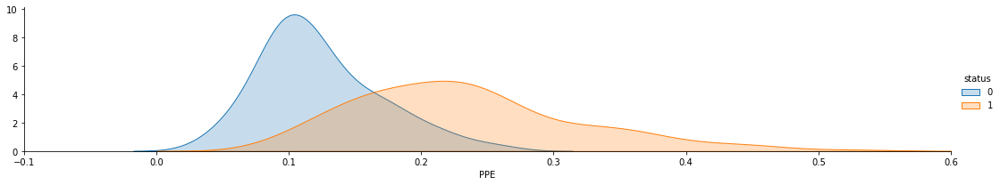

In [ ]:
as_fig = sns.FacetGrid(data,hue='status',aspect=5)

as_fig.map(sns.kdeplot,'PPE',shade=True)

oldest = data['PPE'].max()

as_fig.set(xlim=(-0.1,0.6))

as_fig.add_legend()

##People having a "PPE" frequency range higher than 0.252404 suffer with PD.

#Column "MDVP:Fo(Hz)" ,	"MDVP:Fhi(Hz)" ,	"MDVP:Flo(Hz)"

---





/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

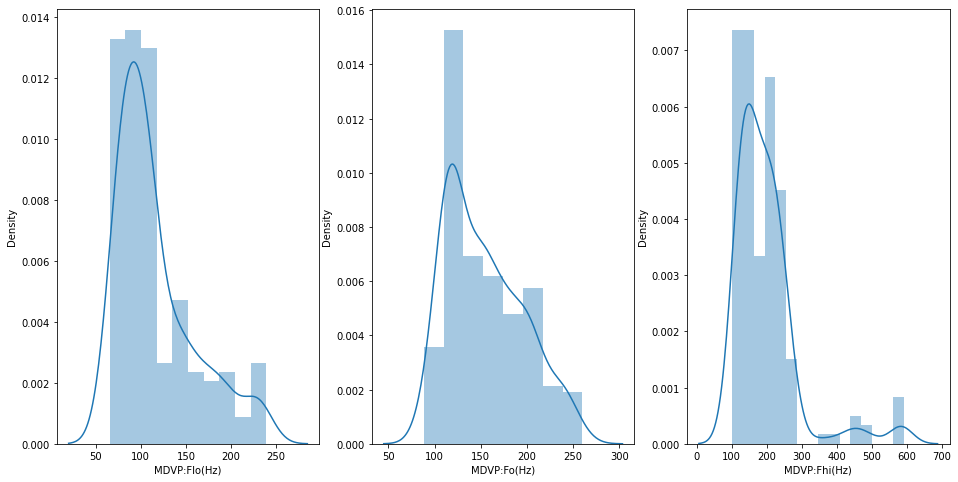

In [ ]:
fig, ax = plt.subplots(1,3,figsize=(16,8)) 
sns.distplot(data['MDVP:Flo(Hz)'],ax=ax[0]) 
sns.distplot(data['MDVP:Fo(Hz)'],ax=ax[1]) 
sns.distplot(data['MDVP:Fhi(Hz)'],ax=ax[2])

##MDVP:Flo(Hz) is right skewed with a range (65.476000 to 239.170000).
##MDVP:Fo(Hz) is almost normally distributed with a range (88.333000 to 260.105000).
##MDVP:Fhi(Hz) is almost normally distributed with a range (102.145000 to 592.030000) with few outliers.



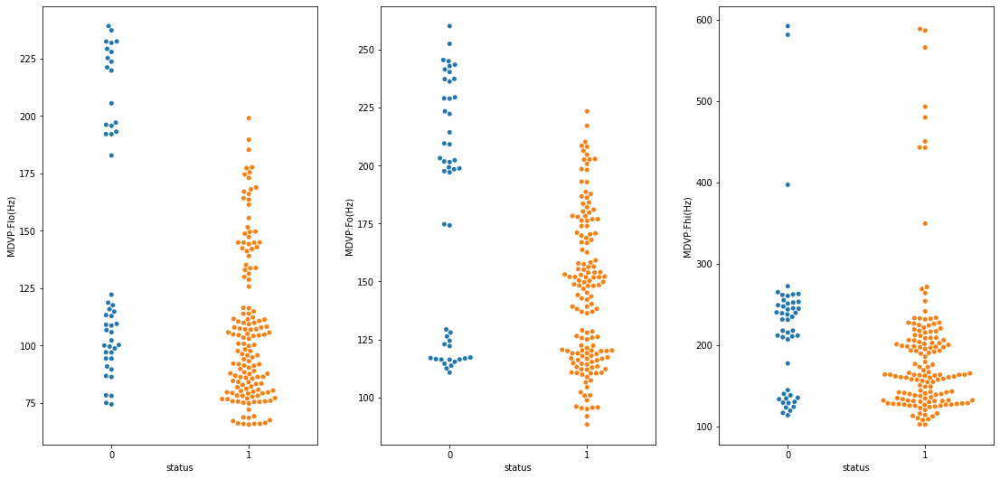

In [ ]:
fig, ax = plt.subplots(1,3,figsize=(16,8)) 
sns.swarmplot(data=data, y='MDVP:Flo(Hz)', x='status',ax=ax[0]) 
sns.swarmplot(data=data, y='MDVP:Fo(Hz)', x='status',ax=ax[1])
sns.swarmplot(data=data, y='MDVP:Fhi(Hz)', x='status',ax=ax[2])
fig.tight_layout(pad=3.0)

##Healthy people doesn't have 125 to 175 minimum vocal frequency.
##Healthy people doesn't have 130 to 160 avg vocal frequency.

#Column "MDVP:Jitter(%)" , "MDVP:Jitter(Abs)" , "MDVP:RAP" , "MDVP:PPQ" , "Jitter:DDP"

---





/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will b

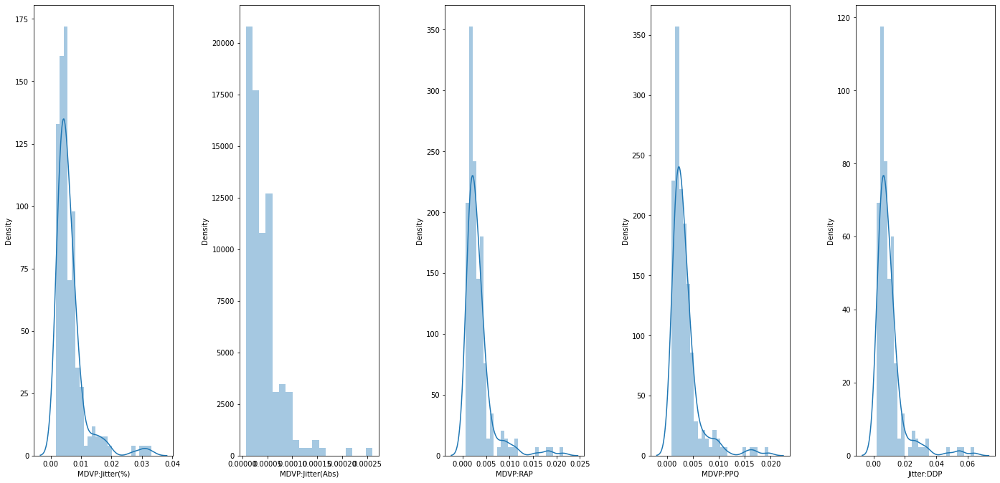

In [ ]:
fig, ax = plt.subplots(1,5,figsize=(20,10)) 
sns.distplot(data['MDVP:Jitter(%)'],ax=ax[0]) 
sns.distplot(data['MDVP:Jitter(Abs)'],ax=ax[1]) 
sns.distplot(data['MDVP:RAP'],ax=ax[2])
sns.distplot(data['MDVP:PPQ'],ax=ax[3]) 
sns.distplot(data['Jitter:DDP'],ax=ax[4])

fig.tight_layout(pad=3.0)

##Several measures of variation in fundamental frequency has too many outliers.

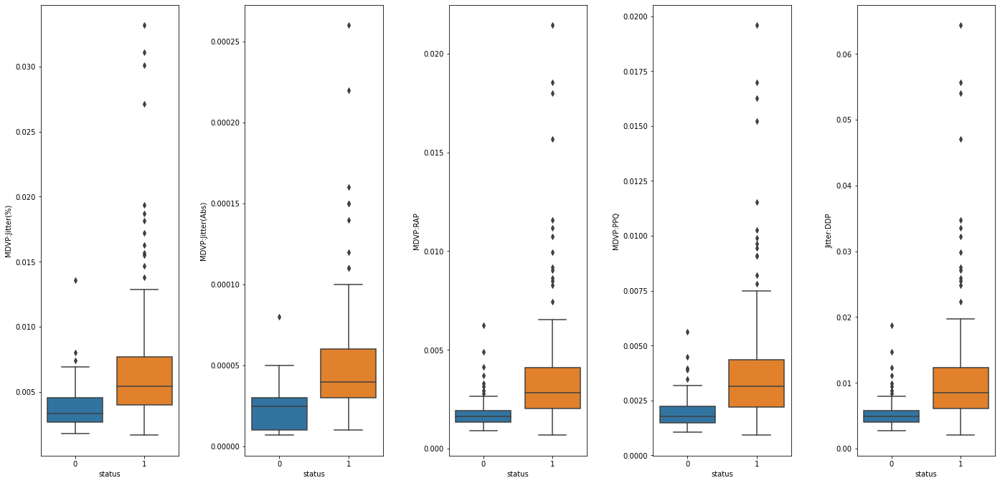

In [ ]:
fig, ax = plt.subplots(1,5,figsize=(20,10)) 
sns.boxplot(data=data, y='MDVP:Jitter(%)', x='status',ax=ax[0]) 
sns.boxplot(data=data, y='MDVP:Jitter(Abs)', x='status',ax=ax[1])
sns.boxplot(data=data, y='MDVP:RAP', x='status',ax=ax[2])
sns.boxplot(data=data, y='MDVP:PPQ', x='status',ax=ax[3])
sns.boxplot(data=data, y='Jitter:DDP', x='status',ax=ax[4])
fig.tight_layout(pad=3.0)

##Several measures of variation in fundamental frequency is high for those suffering with PD while those healthy has a much low range.

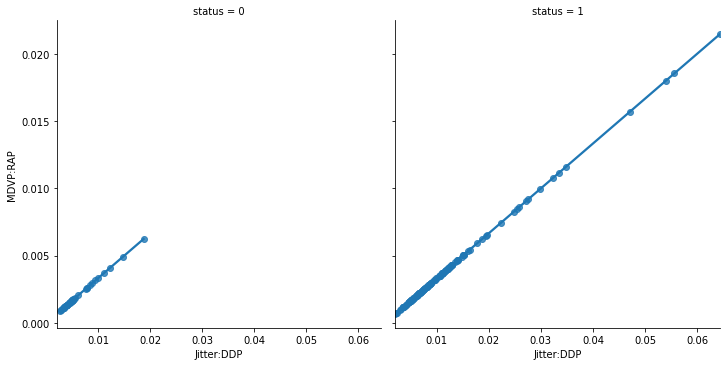

In [ ]:
sns.lmplot(data=data, x="Jitter:DDP", y="MDVP:RAP",col="status")

##We see Jitter:DDP and MDVP:RAP is linearly dependant on each other, we will check which feature has the highest corr with status so that we can drop the next.

In [ ]:
data[['Jitter:DDP','MDVP:RAP','status']].corr()

,Jitter:DDP,MDVP:RAP,status
Jitter:DDP,1.000000,1.000000,0.266646
MDVP:RAP,1.000000,1.000000,0.266668
status,0.266646,0.266668,1.000000


In [ ]:
data.drop(['Jitter:DDP'],inplace=True, axis = 1)
print("Done.")

Done.


#'MDVP:Shimmer' , 'MDVP:Shimmer(dB)' , 'Shimmer:APQ3' , 'Shimmer:APQ5' , 'MDVP:APQ' , 'Shimmer:DDA' - Several measures of variation in amplitude.

---






/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

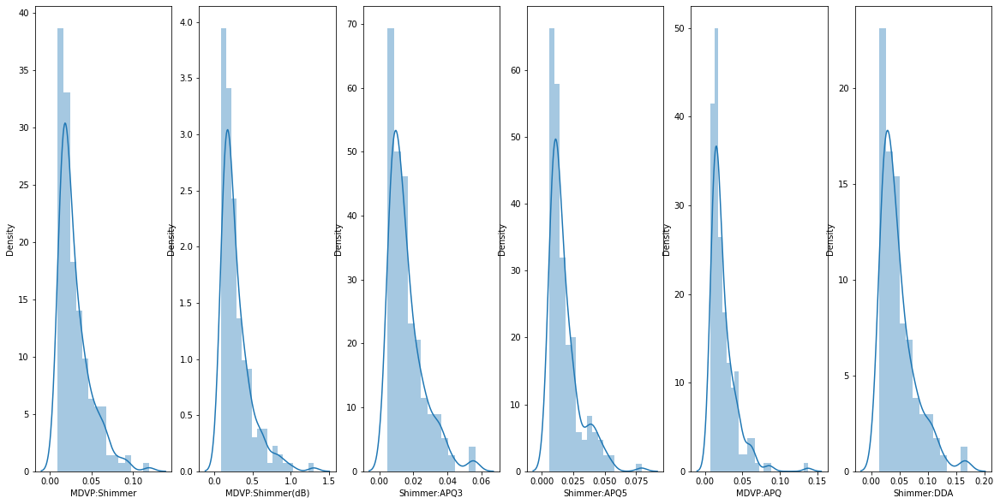

In [ ]:
fig, ax = plt.subplots(1,6,figsize=(20,10)) 
sns.distplot(data['MDVP:Shimmer'],ax=ax[0]) 
sns.distplot(data['MDVP:Shimmer(dB)'],ax=ax[1]) 
sns.distplot(data['Shimmer:APQ3'],ax=ax[2])
sns.distplot(data['Shimmer:APQ5'],ax=ax[3]) 
sns.distplot(data['MDVP:APQ'],ax=ax[4])
sns.distplot(data['Shimmer:DDA'],ax=ax[5])

##Several measures of variation in amplitude as all right skewed.

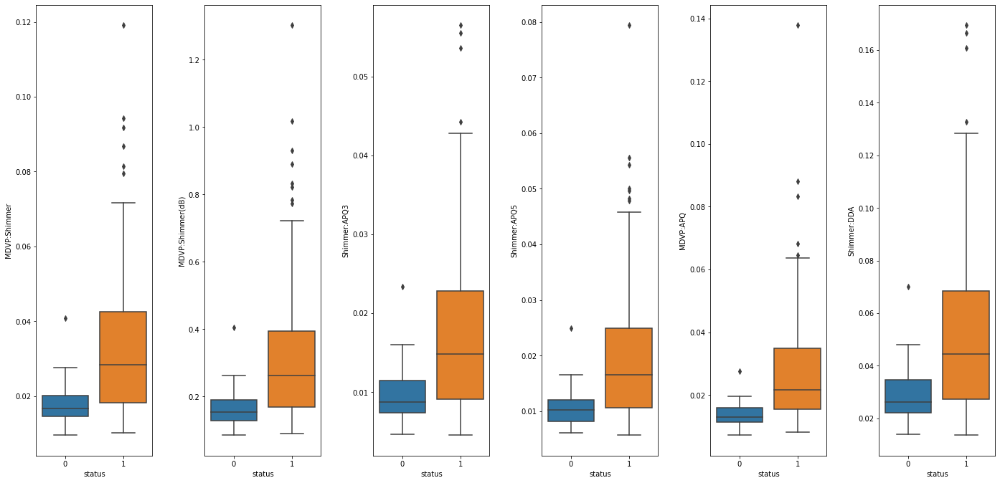

In [ ]:
fig, ax = plt.subplots(1,6,figsize=(20,10)) 
sns.boxplot(data=data, y='MDVP:Shimmer', x='status',ax=ax[0]) 
sns.boxplot(data=data, y='MDVP:Shimmer(dB)', x='status',ax=ax[1])
sns.boxplot(data=data, y='Shimmer:APQ3', x='status',ax=ax[2])
sns.boxplot(data=data, y='Shimmer:APQ5', x='status',ax=ax[3])
sns.boxplot(data=data, y='MDVP:APQ', x='status',ax=ax[4])
sns.boxplot(data=data, y='Shimmer:DDA', x='status',ax=ax[5])
fig.tight_layout(pad=3.0)

##People suffering with PD usually has higher shimmer range.

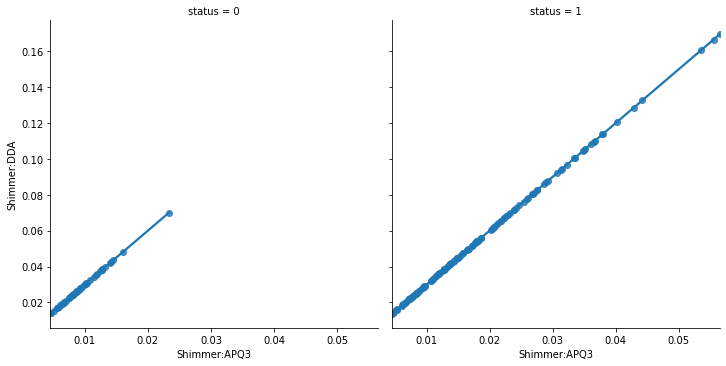

In [ ]:
sns.lmplot(data=data, x="Shimmer:APQ3", y="Shimmer:DDA",col="status")

##We see Shimmer:APQ3 and Shimmer:DDA is linearly dependant on each other, we will check which feature has the highest corr with status so that we can drop the next.

In [ ]:
data[['Shimmer:DDA','Shimmer:APQ3','status']].corr()

,Shimmer:DDA,Shimmer:APQ3,status
Shimmer:DDA,1.000000,1.000000,0.347608
Shimmer:APQ3,1.000000,1.000000,0.347617
status,0.347608,0.347617,1.000000


In [ ]:
data.drop(['Shimmer:DDA'],inplace=True, axis = 1)
print("Done.")

Done.


#Column "NHR" and "HNR"

---





/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


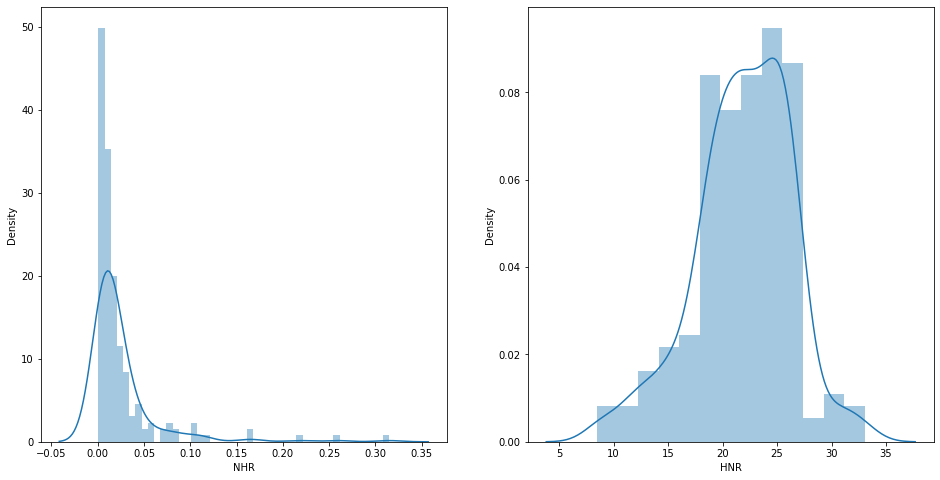

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(16,8)) 
sns.distplot(data['NHR'],ax=ax[0]) 
sns.distplot(data['HNR'],ax=ax[1])

##NHR is right skewed while HNR is left skewed.

In [ ]:
data.groupby("status")["HNR",'NHR'].describe()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


HNR                       ...       NHR                   
        count       mean       std  ...       50%       75%      max
status                              ...                             
0        48.0  24.678750  3.434540  ...  0.004825  0.009213  0.10715
1       147.0  20.974048  4.339143  ...  0.016580  0.027960  0.31482

[2 rows x 16 columns]

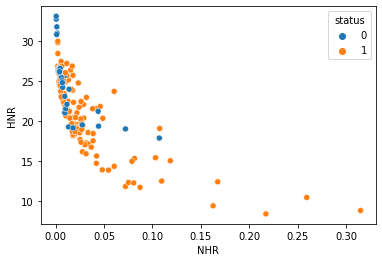

In [ ]:
sns.scatterplot(data=data, x="NHR", y="HNR",hue="status")

##Healthy people usually had high HNR and low NHR.

#Column "RPDE and "D2".

---


/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


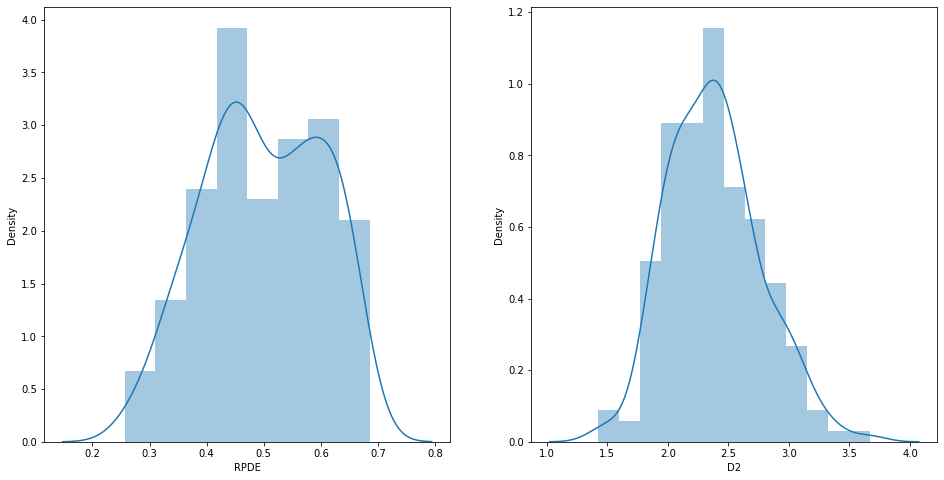

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(16,8)) 
sns.distplot(data['RPDE'],ax=ax[0]) 
sns.distplot(data['D2'],ax=ax[1])

##The range of "RPDE" is from 0.1 to 0.8 and "D2" is 1 to 4.

#Column "DFA"

---





/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


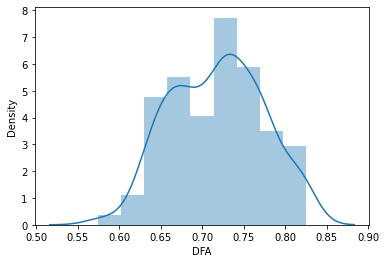

In [ ]:
 sns.distplot(data['DFA'])

##Range of DFA was between 0.50 and 0.90

#Training

---





In [ ]:
X = data.drop("status",axis=1) 
Y = data["status"]

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 0)

##I still feel there are more unecessary columns, so lets check feature importance.

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
model = RandomForestClassifier().fit(X,Y)
important_features = pd.DataFrame((model.feature_importances_*100), index = X.columns, columns=['importance']).sort_values('importance', ascending=False)

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19],
 <a list of 20 Text major ticklabel objects>)

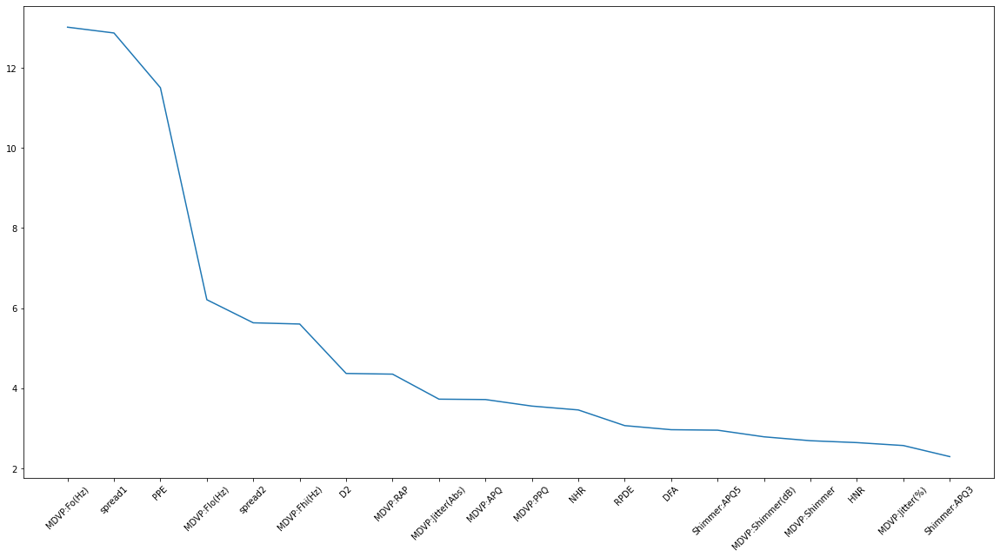

In [ ]:
plt.figure(figsize=(20,10))
plt.plot(important_features)
plt.xticks(rotation=45)

In [ ]:
col=['PPE', 'spread1', 'spread2','MDVP:Fo(Hz)',  'MDVP:Fhi(Hz)',  'MDVP:Flo(Hz)', 'MDVP:RAP','D2']

In [ ]:
#Create a function within many Machine Learning Models
def models(X_train,Y_train):
  
  #Using Logistic Regression Algorithm to the Training Set
  from sklearn.linear_model import LogisticRegression
  log = LogisticRegression(random_state = 0)
  log.fit(X_train, Y_train)
  
  #Using KNeighborsClassifier Method of neighbors class to use Nearest Neighbor algorithm
  from sklearn.neighbors import KNeighborsClassifier
  knn = KNeighborsClassifier(n_neighbors = 5, metric = 'minkowski', p = 2)
  knn.fit(X_train, Y_train)

  #Using SVC method of svm class to use Support Vector Machine Algorithm
  from sklearn.svm import SVC
  svc_lin = SVC(kernel = 'linear', random_state = 0)
  svc_lin.fit(X_train, Y_train)

  #Using SVC method of svm class to use Kernel SVM Algorithm
  from sklearn.svm import SVC
  svc_rbf = SVC(kernel = 'rbf', random_state = 0)
  svc_rbf.fit(X_train, Y_train)

  #Using GaussianNB method of naïve_bayes class to use Naïve Bayes Algorithm
  from sklearn.naive_bayes import GaussianNB
  gauss = GaussianNB()
  gauss.fit(X_train, Y_train)

  #Using DecisionTreeClassifier of tree class to use Decision Tree Algorithm
  from sklearn.tree import DecisionTreeClassifier
  tree = DecisionTreeClassifier(criterion = 'entropy', random_state = 0)
  tree.fit(X_train, Y_train)

  #Using RandomForestClassifier method of ensemble class to use Random Forest Classification algorithm
  from sklearn.ensemble import RandomForestClassifier
  forest = RandomForestClassifier(n_estimators = 10, criterion = 'entropy', random_state = 0)
  forest.fit(X_train, Y_train)

  #Using GradientBoostingClassifier method of ensemble class to use Gradient Boosting Classifier algorithm
  from sklearn.ensemble import GradientBoostingClassifier
  gbcl = GradientBoostingClassifier(n_estimators = 50, learning_rate = 0.05)
  gbcl.fit(X_train,Y_train)  
  
  #print model accuracy on the training data.
  print('[0]Logistic Regression Training Accuracy:', log.score(X_train, Y_train))
  print('[1]K Nearest Neighbor Training Accuracy:', knn.score(X_train, Y_train))
  print('[2]Support Vector Machine (Linear Classifier) Training Accuracy:', svc_lin.score(X_train, Y_train))
  print('[3]Support Vector Machine (RBF Classifier) Training Accuracy:', svc_rbf.score(X_train, Y_train))
  print('[4]Gaussian Naive Bayes Training Accuracy:', gauss.score(X_train, Y_train))
  print('[5]Decision Tree Classifier Training Accuracy:', tree.score(X_train, Y_train))
  print('[6]Random Forest Classifier Training Accuracy:', forest.score(X_train, Y_train))
  print('[7]Gradient Boosting Classifier Training Accuracy:', gbcl.score(X_train , Y_train))

  return log, knn, svc_lin, svc_rbf, gauss, tree, forest, gbcl

In [ ]:
model = models(X_train[col],Y_train)

/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


[0]Logistic Regression Training Accuracy: 0.8525641025641025
[1]K Nearest Neighbor Training Accuracy: 0.8910256410256411
[2]Support Vector Machine (Linear Classifier) Training Accuracy: 0.8589743589743589
[3]Support Vector Machine (RBF Classifier) Training Accuracy: 0.8076923076923077
[4]Gaussian Naive Bayes Training Accuracy: 0.7692307692307693
[5]Decision Tree Classifier Training Accuracy: 1.0
[6]Random Forest Classifier Training Accuracy: 0.9935897435897436
[7]Gradient Boosting Classifier Training Accuracy: 0.9935897435897436


In [ ]:
from sklearn.metrics import confusion_matrix 
for i in range(len(model)):
   cm = confusion_matrix(Y_test, model[i].predict(X_test[col])) 
   #extracting TN, FP, FN, TP
   TN, FP, FN, TP = confusion_matrix(Y_test, model[i].predict(X_test[col])).ravel()
   print(cm)
   print('Model[{}] Testing Accuracy = "{} !"'.format(i,  (TP + TN) / (TP + TN + FN + FP)))
   print()# Print a new line

[[ 7  3]
 [ 1 28]]
Model[0] Testing Accuracy = "0.8974358974358975 !"

[[ 6  4]
 [ 1 28]]
Model[1] Testing Accuracy = "0.8717948717948718 !"

[[ 7  3]
 [ 0 29]]
Model[2] Testing Accuracy = "0.9230769230769231 !"

[[ 5  5]
 [ 0 29]]
Model[3] Testing Accuracy = "0.8717948717948718 !"

[[ 7  3]
 [ 6 23]]
Model[4] Testing Accuracy = "0.7692307692307693 !"

[[ 9  1]
 [ 3 26]]
Model[5] Testing Accuracy = "0.8974358974358975 !"

[[ 8  2]
 [ 1 28]]
Model[6] Testing Accuracy = "0.9230769230769231 !"

[[ 9  1]
 [ 1 28]]
Model[7] Testing Accuracy = "0.9487179487179487 !"



In [ ]:
from sklearn.metrics import accuracy_score

In [ ]:
m = ['Logistic','KNN','SVC-Linear','SVC-RBF','GaussianNB','DecisionTree', 'RandomForest','GradientBoosting']
def create_score(model,X_train,X_test):
    Accuracy_data = []
    for i in range(len(model)):
        train_result = accuracy_score(Y_train,model[i].predict(X_train[col]))
        test_result = accuracy_score(Y_test,model[i].predict(X_test[col]))
        Accuracy_data.append([train_result,test_result])

    return pd.DataFrame(Accuracy_data,columns = ['Train score','Test score'])

scr = create_score(model,X_train[col],X_test[col])
scr['models'] = m
scr.set_index("models")

,Train score,Test score
models,,
Logistic,0.852564,0.897436
KNN,0.891026,0.871795
SVC-Linear,0.858974,0.923077
SVC-RBF,0.807692,0.871795
GaussianNB,0.769231,0.769231
DecisionTree,1.000000,0.897436
RandomForest,0.993590,0.923077
GradientBoosting,0.993590,0.948718


#Hence it can be concluded that the best model for my prediction is Gradient Boosting since it gives the highest accuracy and less deviation from training.